In [1]:
# Analysis and Visualization for Migros-Denner chain
## Group Project / CA
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
import json


In [2]:
df = pd.read_csv('../data/df_switzerland_denner.csv')

In [3]:
with open("../data/georef-switzerland-kanton@public.geojson") as response:
    cantons = json.load(response)

In [5]:

df1 = df.copy()

denner_per_canton = df1.groupby('Canton').size().reset_index(name='count')
# denner_per_canton
# # mapping denners per canton
# fig = px.choropleth_mapbox(
#     denner_per_canton, 
#     color="count",
#     geojson=cantons, 
#     locations="Canton", 
#     featureidkey="properties.kan_name",
#     center={"lat": 46.8, "lon": 8.3},
#     mapbox_style="open-street-map", 
#     zoom=6.3,
#     opacity=0.8,
#     width=900,
#     height=500,
#     labels={"Canton":"Canton",
#            "count":"Number of Denners"},
#     title="<b>Denners per Canton</b>",
#     color_continuous_scale="Cividis",
# )
# fig.update_layout(margin={"r":0,"t":35,"l":0,"b":0},
#                   font={"family":"Sans",
#                        "color":"maroon"},
#                   hoverlabel={"bgcolor":"white", 
#                               "font_size":12,
#                              "font_family":"Helvetica"},
#                   title={"font_size":20,
#                         "xanchor":"left", "x":0.01,
#                         "yanchor":"bottom", "y":0.95}
#                  )
# fig.show()



In [6]:
rating_per_canton = df1.groupby('Canton')['Rating'].agg('mean').reset_index(name='mean_rating')
sorted_rating = rating_per_canton.sort_values(by='mean_rating', ascending=False)

In [18]:
population = pd.read_csv('../data/pop_denn.csv')
population.fillna(0, inplace=True)


In [24]:
#population['2022'] = population['2022'].str.replace(',', '').astype(int)
population

,canton,2022,denners
0,Vaud,830431,40.0
1,Valais,357282,21.0
2,Geneva,514114,0.0
3,Bern,1051437,21.0
4,Fribourg,334465,8.0
5,Solothurn,282408,3.0
6,Neuchâtel,176571,5.0
7,Jura,73865,4.0
8,Basel-Stadt,196786,18.0
9,Basel-Landschaft,294417,1.0


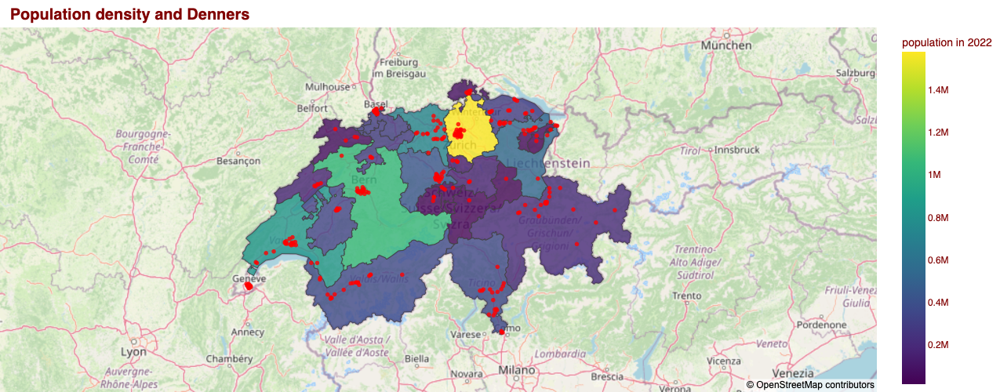

In [25]:
# # Each denner on the map
# fig = px.scatter_mapbox(df1, lat="Latitude", lon="Longitude", center={"lat": 46.8, "lon": 8.3},
#     mapbox_style="open-street-map", 
#     zoom=6.3,
#     opacity=0.8,
#     width=900,
#     height=500,
#     title="Denners in Switzerland")
#     #labels={"Canton":"Canton"})

# fig.show()
# population = pd.read_csv('../data/pop_denn.csv')
# population.fillna(0, inplace=True)

fig = px.choropleth_mapbox(
    population, 
    color='2022',
    color_continuous_scale='viridis',
    geojson=cantons, 
    locations="canton", 
    featureidkey="properties.kan_name",
    center={"lat": 46.8, "lon": 8.3},
    mapbox_style="open-street-map", 
    zoom=6.3,
    opacity=0.8,
    width=900,
    height=500,
    labels={"canton":"Canton",
           "2022":"population in 2022"},
    title="<b>Population density and Denners</b>"
    
)
fig.update_layout(margin={"r":0,"t":35,"l":0,"b":0},
                  font={"family":"Helvetica",
                       "color":"maroon"},
                  hoverlabel={"bgcolor":"white", 
                              "font_size":12,
                             "font_family":"Helvetica"},
                  title={"font_size":20,
                        "xanchor":"left", "x":0.01,
                        "yanchor":"bottom", "y":0.95}
                 )

fig2 = px.scatter_mapbox(df1, lat="Latitude", lon="Longitude",
                         size_max=15,  # Color the dots based on a column
                         color_discrete_sequence=["red"], # Choose a color scale
                         center={"lat": 46.8, "lon": 8.3},
                         mapbox_style="open-street-map", 
                         zoom=6.3,
                         opacity=0.8,
                         width=900,
                         height=500) 
trace0 = fig2 # the second map from the previous code
fig.add_trace(trace0.data[0])
trace0.layout.update(showlegend=False)
fig.show()


In [20]:
## Analysis of population and projections
# Loading data on the population projection
projection = pd.read_csv('../data/per_change.csv')

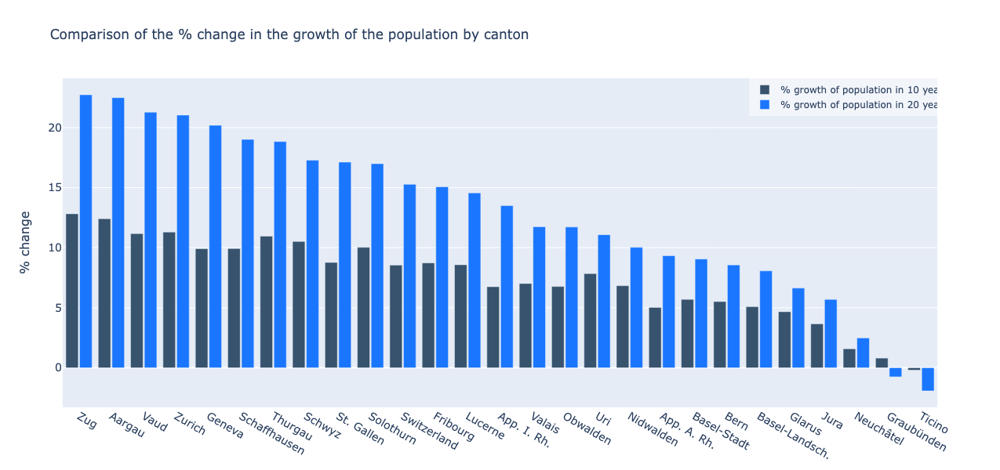

In [14]:
## Analysis of population and projections
# Loading data on the population projection
#projection = pd.read_csv('projections_pop.csv')
# Percentage change calculation

#projection['per_change_10y'] = (projection['2030'] - projection['2020'])/projection['2020'] * 100
#projection['per_change_20y'] = (projection['2040'] - projection['2020'])/projection['2020'] * 100
#projection.to_csv('per_change.csv')

# Preparing data for the column chart on the projection of the population 
projection = pd.read_csv('../data/per_change.csv')
viz1 = projection[['Canton','per_change_10y', 'per_change_20y']]
viz1 = viz1.sort_values(by='per_change_20y', ascending=False)
# Column chart for the 10 and 20 years population projection
fig = go.Figure()
fig.add_trace(go.Bar(x=viz1['Canton'],
                y=viz1['per_change_10y'],
                name='% growth of population in 10 years',
                marker_color='rgb(55, 83, 109)'
                ))
fig.add_trace(go.Bar(x=viz1['Canton'],
                y=viz1['per_change_20y'],
                name='% growth of population in 20 years',
                marker_color='rgb(26, 118, 255)'
                ))

fig.update_layout(
    title='Comparison of the % change in the growth of the population by canton',
    xaxis_tickfont_size=14,
    yaxis=dict(
        title='% change',
        titlefont_size=16,
        tickfont_size=14,
    ),
    legend=dict(
        x=0,
        y=1.0,
        bgcolor='rgba(255, 255, 255, 0)',
        bordercolor='rgba(255, 255, 255, 0)'
    ),
    barmode='group',
    bargap=0.15, # gap between bars of adjacent location coordinates.
    bargroupgap=0.1,
    width=1000, # Set the width of the figure
    height=600 # gap between bars of the same location coordinate.
)

fig.update_layout(
    legend=dict(
        x=1,
        y=1,
        xanchor='right',  # Anchors the legend to the right
        yanchor='top',
        bgcolor='rgba(255, 255, 255, 0.5)'  # Anchors the legend to the bottom
    )
)

fig.show()


In [27]:
migros_geo = pd.read_csv('../data/df_switzerland_migros_geocoded.csv')


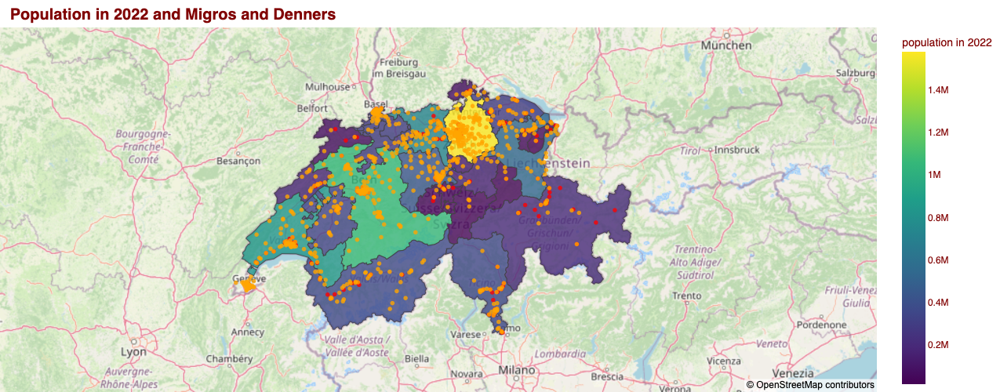

In [28]:

# Map of Migros + Denners on the population density in 2022

fig = px.choropleth_mapbox(
    population, 
    color='2022',
    color_continuous_scale='viridis',
    geojson=cantons, 
    locations="canton", 
    featureidkey="properties.kan_name",
    center={"lat": 46.8, "lon": 8.3},
    mapbox_style="open-street-map", 
    zoom=6.3,
    opacity=0.8,
    width=900,
    height=500,
    labels={"canton":"Canton",
           "2022":"population in 2022"},
    title="<b>Population in 2022 and Migros and Denners</b>"
    
)
fig.update_layout(margin={"r":0,"t":35,"l":0,"b":0},
                  font={"family":"Helvetica",
                       "color":"maroon"},
                  hoverlabel={"bgcolor":"white", 
                              "font_size":12,
                             "font_family":"Helvetica"},
                  title={"font_size":20,
                        "xanchor":"left", "x":0.01,
                        "yanchor":"bottom", "y":0.95}
                 )

fig2 = px.scatter_mapbox(df1, lat="Latitude", lon="Longitude",
                         size_max=15,  # Color the dots based on a column
                         color_discrete_sequence=["red"], # Choose a color scale
                         center={"lat": 46.8, "lon": 8.3},
                         mapbox_style="open-street-map", 
                         zoom=6.3,
                         opacity=0.8,
                         width=900,
                         height=500) 

fig3 = px.scatter_mapbox(migros_geo, lat="Latitude", lon="Longitude",
                         size_max=15,  # Color the dots based on a column
                         color_discrete_sequence=["orange"], # Choose a color scale
                         center={"lat": 46.8, "lon": 8.3},
                         mapbox_style="open-street-map", 
                         zoom=6.3,
                         opacity=0.8,
                         width=900,
                         height=500) 
trace0 = fig2
trace1 = fig3# the second map from the previous code
fig.add_trace(trace0.data[0])
fig.add_trace(trace1.data[0])
trace0.layout.update(showlegend=True)
trace1.layout.update(showlegend=True)
fig.show()


In [30]:
df_migros = pd.read_csv('../data/df_switzerland_migros.csv')
#df_migros.head()
# pip install geopy

# from geopy.geocoders import Nominatim
# from geopy.extra.rate_limiter import RateLimiter
# # Initialize the geolocator
# # Adjust the timeout for the geocode call
# geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1, error_wait_seconds=10)

# # You might also need to adjust the geolocator's timeout directly
# geolocator = Nominatim(user_agent="geoapiExercises", timeout=10)  # Increase timeout to 10 seconds

# # Define a function to get longitude and latitude for a given address
# def get_lat_lon(address):
#     try:
#         location = geocode(address)
#         return location.latitude, location.longitude
#     except:
#         # In case the geocoding fails, return NaN or some indication
#         return None, None

# # Apply the function to your DataFrame
# df['latitude'], df['longitude'] = zip(*df_migros['Address'].apply(get_lat_lon))
#df_migros.head()




#population
#merged_df = merged_df.drop(columns=['count_mig', 'count'])
#merged_df.rename(columns={'Canton': 'canton'}, inplace=True)


In [32]:
migros_per_canton = df_migros.groupby('Canton').size().reset_index(name='count')
#migros_per_canton['count'] = migros_per_canton['count']
#migros_per_canton.drop(['count'], axis=1, inplace=True)
migros_per_canton

,Canton,count
0,Aargau,70
1,Basel-Landschaft,29
2,Basel-Stadt,25
3,Bern,105
4,Fribourg,27
5,Genève,35
6,Graubünden,13
7,Jura,3
8,Lucerne,1
9,Luzern,31


In [33]:
#migros_per_canton.merge(denner_per_canton, how=)
merged_df = pd.merge(migros_per_canton, denner_per_canton, on='Canton', how='left')
merged_df.fillna(0, inplace=True)
merged_df

,Canton,count_x,count_y
0,Aargau,70,18.0
1,Basel-Landschaft,29,1.0
2,Basel-Stadt,25,18.0
3,Bern,105,21.0
4,Fribourg,27,8.0
5,Genève,35,0.0
6,Graubünden,13,20.0
7,Jura,3,4.0
8,Lucerne,1,0.0
9,Luzern,31,19.0


In [34]:
merged_df['counts'] = merged_df['count_x'] + merged_df['count_y']
merged_df

,Canton,count_x,count_y,counts
0,Aargau,70,18.0,88.0
1,Basel-Landschaft,29,1.0,30.0
2,Basel-Stadt,25,18.0,43.0
3,Bern,105,21.0,126.0
4,Fribourg,27,8.0,35.0
5,Genève,35,0.0,35.0
6,Graubünden,13,20.0,33.0
7,Jura,3,4.0,7.0
8,Lucerne,1,0.0,1.0
9,Luzern,31,19.0,50.0


In [48]:
#merged_df['canton'] = merged_df['canton'].replace('Genève', 'Geneve')
#merged_df

pop_index1 = pd.merge(merged_df, population, left_on='Canton', right_on='canton', how='left' )
columns_drop = ['count_x', 'count_y','canton','denners']
pop_index1 = pop_index1.drop(columns=columns_drop)
#pop_index1['shop_rate'] = round(((pop_index1['counts'] / pop_index1['2022']) * 10000), 1)
pop_index1
#pop_index1 = pop_index1.sort_values(by='shop_rate', ascending=False)
#pop_index_top5 = pop_index1.iloc[:6]

#pop_index_top5.to_csv('../data/pop_index_top5.csv')
#top5_index = pd.read_csv('../data/pop_index_top5.csv')


,Canton,counts,2022
0,Aargau,88.0,711232.0
1,Basel-Landschaft,30.0,294417.0
2,Basel-Stadt,43.0,196786.0
3,Bern,126.0,1051437.0
4,Fribourg,35.0,334465.0
5,Genève,35.0,NaN
6,Graubünden,33.0,202538.0
7,Jura,7.0,73865.0
8,Lucerne,1.0,NaN
9,Luzern,50.0,424851.0


In [50]:
pop_index1

,Canton,counts,2022
0,Aargau,88.0,711232.0
1,Basel-Landschaft,30.0,294417.0
2,Basel-Stadt,43.0,196786.0
3,Bern,126.0,1051437.0
4,Fribourg,35.0,334465.0
5,Genève,35.0,0.0
6,Graubünden,33.0,202538.0
7,Jura,7.0,73865.0
8,Lucerne,1.0,0.0
9,Luzern,50.0,424851.0


In [49]:
pop_index1.fillna(0, inplace=True)

In [51]:
pop_index1['shop_rate'] = round(((pop_index1['counts'] / pop_index1['2022']) * 10000), 1)
pop_index1


,Canton,counts,2022,shop_rate
0,Aargau,88.0,711232.0,1.2
1,Basel-Landschaft,30.0,294417.0,1.0
2,Basel-Stadt,43.0,196786.0,2.2
3,Bern,126.0,1051437.0,1.2
4,Fribourg,35.0,334465.0,1.0
5,Genève,35.0,0.0,inf
6,Graubünden,33.0,202538.0,1.6
7,Jura,7.0,73865.0,0.9
8,Lucerne,1.0,0.0,inf
9,Luzern,50.0,424851.0,1.2


In [58]:
pop_index1 = pop_index1.sort_values(by='shop_rate', ascending=False)
pop_index_top5 = pop_index1.iloc[:7]

In [61]:
pop_index_top5 = pop_index_top5.drop([5, 8])



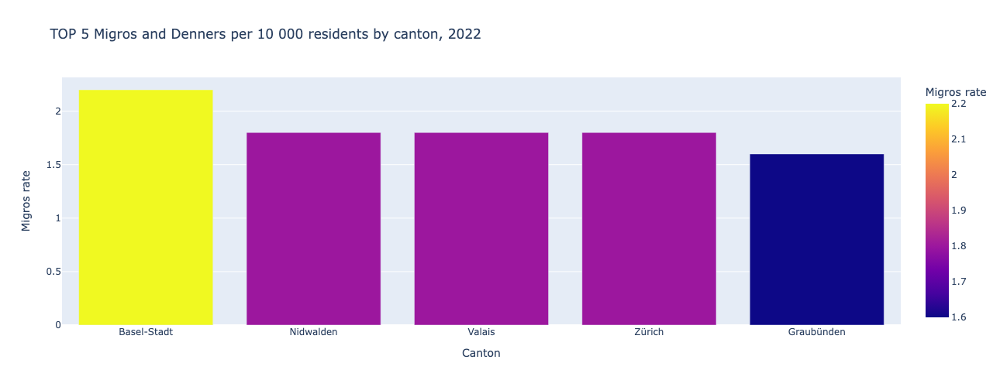

In [63]:
#top5_index
fig = px.bar(pop_index_top5, x='Canton', y='shop_rate',
             hover_data=['Canton'], color='shop_rate',
             labels={'shop_rate':'Migros rate'}, height=500, width=600,
            title='TOP 5 Migros and Denners per 10 000 residents by canton, 2022')
fig.show()
#pop_index1

In [64]:
pop_index1['counts'].sum()

1049.0

In [67]:
df2 = pd.read_csv('../data/df_switzerland_migros_geocoded.csv')

df2.head()

,Address,Street Name,Zip Code,City,Canton,Country,Latitude,Longitude,Rating,Number of Ratings,...,Tuesday_Close,Wednesday_Close,Thursday_Close,Friday_Close,Saturday_Close,Brand,Type,Store ID,Name,Opening Hour
0,"Baarerstrasse 22, 6300 Zug, Switzerland",Baarerstrasse 22,6300,Zug,Zug,Switzerland,47.173133,8.518225,4.3,780.0,...,1900.0,1900.0,2000.0,1900.0,1700.0,MIGROS,NaN,NaN,NaN,NaN
1,"Grabenstrasse 5, 6300 Zug, Switzerland",Grabenstrasse 5,6300,Zug,Zug,Switzerland,47.165276,8.515132,4.3,104.0,...,1900.0,1900.0,1900.0,1900.0,1700.0,MIGROS,NaN,NaN,NaN,NaN
2,"Hertizentrum 10, 6300 Zug, Switzerland",Hertizentrum 10,6300,Zug,Zug,Switzerland,47.178032,8.505905,4.4,172.0,...,1900.0,1900.0,1900.0,2000.0,1700.0,MIGROS,NaN,NaN,NaN,NaN
3,"Hinterbergstrasse 40, 6312 Steinhausen, Switze...",Hinterbergstrasse 40,6312,Steinhausen,Zug,Switzerland,47.192478,8.476918,4.5,744.0,...,1900.0,1900.0,1900.0,2100.0,1700.0,MIGROS,NaN,NaN,NaN,NaN
4,"Industriestrasse 15B, 6300 Zug, Switzerland",Industriestrasse 15B,6300,Zug,Zug,Switzerland,47.173310,8.518142,3.9,24.0,...,2000.0,2000.0,2000.0,1700.0,1200.0,MIGROS,NaN,NaN,NaN,NaN


In [68]:
df2.groupby('Canton').size().reset_index(name='counts')

,Canton,counts
0,Aargau,70
1,Basel-Landschaft,29
2,Basel-Stadt,25
3,Bern,105
4,Fribourg,27
5,Genève,35
6,Graubünden,13
7,Jura,3
8,Lucerne,1
9,Luzern,31
